# Double pendulum using Lagrange's equation

Defines a DoublePendulum class that is used to generate double pendulum plots from solving Lagrange's equations.

* Last revised 22-April-2019 by Lucas D. Smith (smith.10444@osu.edu).
* Adapted from Lagrangian_pendulum, Dick Furnstahl






## Euler-Lagrange equations

For a double pendulum, the Kinetic energy, $T$, with generalized coordinates $\phi_{1}, \phi_{2}$ is

$\begin{align}
  T = \dfrac{1}{2}(m_{1}+m_{2})L_{1}^{2}\dot\phi_{1}^{2} + 
      m_{2}L_{1}L_{2}\dot\phi_{1}\dot\phi_{2}\cos{(\phi_{1}-\phi_{2})} + 
      \dfrac{1}{2}m_{2}L_{2}^{2}\dot\phi_{2}^{2},
\end{align}$

and the potential energy, $U$, is

$\begin{align}
  U = (m_{1}+m_{2})gL_{1}(1-\cos{\phi_{1}})+m_{2}gL_{2}(1-\cos{\phi_{2}})
\end{align}$

With the Lagrangian, $\mathcal{L} = T - U$, we arrive at the Euler-Lagrange equations for $\phi_{1}$ and  $\phi_{2}$. 

$\begin{align}
 \frac{d}{dt}\frac{\partial\mathcal{L}}{\partial \dot\phi_{1}} = \frac{\partial\mathcal L}{\partial\phi_{1}}
 \quad\Longrightarrow\quad
 (m_{1}+m_{2})L_{1}^{2}\ddot\phi_{1}+m_{2}L_{1}L_{2}\ddot\phi_{2}\cos{(\phi_{1}-\phi_{2})} =  -m_{2}L_{2}\dot\phi_{2}^{2}\sin{(\phi_{1}-\phi_{2})}-g(m_{1}+m_{2})\sin{\phi_{1}} 
\end{align}$

$\begin{align}
 \frac{d}{dt}\frac{\partial\mathcal{L}}{\partial \dot\phi_{2}} = \frac{\partial\mathcal L}{\partial\phi_{2}}
 \quad\Longrightarrow\quad
 m_{2}L_{2}\ddot\phi_{2}+m_{2}L_{1}\ddot\phi_{1}\cos{(\phi_{1}-\phi_{2})} = m_{2}L_{1}\dot\phi_{1}^{2}\sin{(\phi_{1}-\phi_{2})} - m_{2}g\sin{\phi_{2}}
\end{align}$

We can then solve these two equations for $\ddot\phi_{1}, \ddot\phi_{2}$ as functions of only $\phi_{1}, \phi_{2}, \dot\phi_{1}, \dot\phi_{2}$. 

$\begin{align}
  \ddot\phi_{1} = \dfrac{m_{2}g\sin{\phi_{2}}\cos{(\phi_{1}-\phi_{2})}-m_{2}L_{1}\dot\phi_{1}^{2}\sin{(\phi_{1}-\phi_{2})}\cos{(\phi_{1}-\phi_{2})} - m_{2}L_{2}\dot\phi_{2}^{2} \sin{(\phi_{1}-\phi_{2})} - (m_{1}+m_{2})g\sin{\phi_{1}}}{L_{1}\big(m_{1} + m_{2} \sin^{2}(\phi_{1} - \phi_{2})\big)}
\end{align}$

$\begin{align}
  \ddot\phi_{2} = \dfrac{(m_{1} + m_{2})g\sin{\phi_{1}}\cos{(\phi_{1}-\phi_{2})} + m_{2}L_{2}\dot\phi_{2}^{2}\sin{(\phi_{1}-\phi_{2})}\cos{(\phi_{1}-\phi_{2})}+(m_{1} + m_{2})L_{1}\dot\phi_{1}^{2}\sin{(\phi_{1}-\phi_{2})} - (m_{1} + m_{2})g\sin{\phi_{2}}}{L_{2}\big(m_{1} + m_{2} \sin^{2}(\phi_{1} - \phi_{2})\big)}
\end{align}$


In [74]:
%matplotlib inline

In [75]:
import numpy as np
from scipy.integrate import odeint, solve_ivp
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML


In [76]:
# The dpi (dots-per-inch) setting will affect the resolution and how large
#  the plots appear on screen and printed.  So you may want/need to adjust 
#  the figsize when creating the figure.
plt.rcParams['figure.dpi'] = 100.    # this is the default for notebook

# Change the common font size (smaller when higher dpi)
font_size = 10
plt.rcParams.update({'font.size': font_size})

## Pendulum class and utility functions

In [77]:
class DoublePendulum():
    """
    Pendulum class implements the parameters and Lagrange's equations for 
     a double pendulum (no driving or damping).
     
    Parameters
    ----------
    l1, l2: length of each pendulum rod
    m1, m2: masses of the pendulum bobs
    g: acceleration due to gravity

    Methods
    -------
    dy_dt(t, y)
        Returns the right side of the differential equation in vector y, 
        given time t and the corresponding value of y.
    """
    def __init__(self, l1=1., l2 = 1., m1=1., m2=1., g=1.
                ):
        self.l1 = l1
        self.l2 = l2
        self.m1 = m1
        self.m2 = m2
        self.g = g
    
    def dy_dt(self, t, y):
        """
        This function returns the right-hand side of the diffeq: 
        [dphi/dt d^2phi/dt^2]
        
        Parameters
        ----------
        t : float
            time 
        y : float
            A 4-component vector with y[0] = phi1(t) 
                                      y[1] = phi2(t)
                                      y[2] = phi1_dot(t)
                                      y[3] = phi2_dot(t)
            
        Returns
        -------
        
        """
        
        sin = np.sin(y[0] - y[1])
        cos = np.cos(y[0] - y[1])
        m_t = self.m1 + self.m2
        phi1 = y[0]
        phi2 = y[1]
        w1 = y[2]
        w2 = y[3]
        denom = self.m1 + self.m2 * (np.sin(phi1 - phi2))**2
        
        return [y[2], y[3],\
                -(m_t * self.g * np.sin(phi1) + self.m2 * self.l2 * w2**2 * sin +\
                self.m2 * self.l1 * w1**2 * sin * cos - self.m2 * self.g * np.sin(phi2) * cos)/\
                                        (self.l1 * denom),\
                (m_t * self.g * np.sin(phi1) * cos + m_t * self.l1 * w1**2 * sin +\
                self.m2 * self.l2 * w2**2 * sin * cos - m_t * self.g * np.sin(phi2))/\
                                        (self.l2 * denom)]
                
    
    def solve_ode(self, t_pts, phi1_0, phi2_0, phi1_dot_0, phi2_dot_0, 
                  abserr=1.0e-9, relerr=1.0e-9):
        """
        Solve the ODE given initial conditions.
        Specify smaller abserr and relerr to get more precision.
        """
        y = [phi1_0, phi2_0, phi1_dot_0, phi2_dot_0] 
        solution = solve_ivp(self.dy_dt, (t_pts[0], t_pts[-1]), 
                             y, t_eval=t_pts, 
                             atol=abserr, rtol=relerr)
        phi1, phi2, phi1_dot, phi2_dot = solution.y

        return phi1, phi2, phi1_dot, phi2_dot

In [78]:
def plot_y_vs_x(x, y, axis_labels=None, label=None, title=None, 
                color=None, linestyle=None, semilogy=False, loglog=False,
                ax=None):
    """
    Generic plotting function: return a figure axis with a plot of y vs. x,
    with line color and style, title, axis labels, and line label
    """
    if ax is None:        # if the axis object doesn't exist, make one
        ax = plt.gca()

    if (semilogy):
        line, = ax.semilogy(x, y, label=label, 
                            color=color, linestyle=linestyle)
    elif (loglog):
        line, = ax.loglog(x, y, label=label, 
                          color=color, linestyle=linestyle)
    else:
        line, = ax.plot(x, y, label=label, 
                    color=color, linestyle=linestyle)

    if label is not None:    # if a label if passed, show the legend
        ax.legend()
    if title is not None:    # set a title if one if passed
        ax.set_title(title)
    if axis_labels is not None:  # set x-axis and y-axis labels if passed  
        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])

    return ax, line

In [82]:
# Common plotting time (generate the full time then use slices)
t_start = 0.
t_end = 600.
delta_t = .1

t_pts = np.arange(t_start, t_end+delta_t, delta_t)  

l1 = 1.
l2 = 1.
m1 = 1.
m2 = 1.
g=1.

# Instantiate a pendulum 
p1 = DoublePendulum(l1, l2, m1, m2, g)
p2 = DoublePendulum(l1, l2, m1, m2, g)

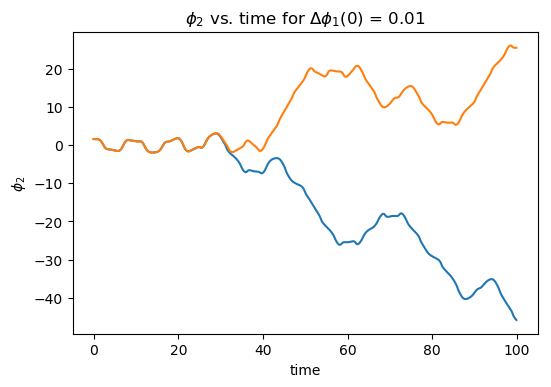

In [83]:
phi1_0 = np.pi/2.
phi2_0 = np.pi/2.
phi1_dot_0 = 0.
phi2_dot_0 = 0.
phi1_a, phi2_a, phi1_dot_a, phi2_dot_a = p1.solve_ode(t_pts, phi1_0, phi2_0, phi1_dot_0, phi2_dot_0)
phi1_b, phi2_b, phi1_dot_b, phi2_dot_b = p1.solve_ode(t_pts, phi1_0+0.01, phi2_0, phi1_dot_0, phi2_dot_0)

t_stop = 100

plt.plot(t_pts[0:int(t_stop/delta_t)], phi2_a[0:int(t_stop/delta_t)])
plt.plot(t_pts[0:int(t_stop/delta_t)], phi2_b[0:int(t_stop/delta_t)])

plt.xlabel('time');
plt.ylabel('$\phi_2$');
plt.title('$\phi_2$ vs. time for $\Delta \phi_{1} (0)$ = 0.01');

This plot of $\phi_{2}$ vs $t$ visually shows how a small difference in initial conditions (in this case, $\Delta \phi_{1} (0) =  0.01$)can lead to wildly different behavior as time goes on (sensitivity to initial conditions). 

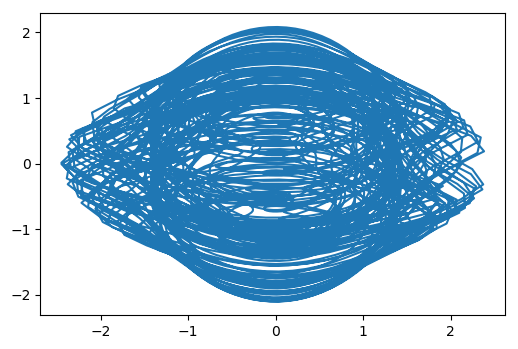

In [84]:
plt.plot(phi1_dot_b, phi1_b)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


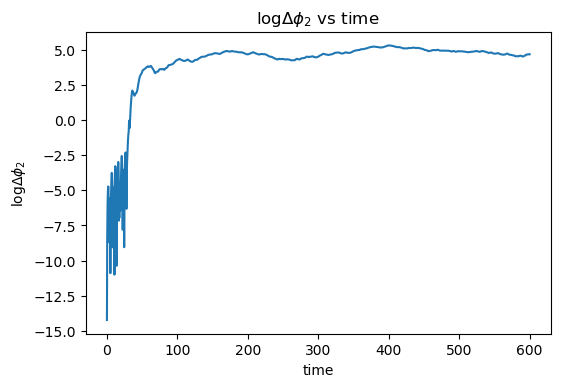

In [85]:
delta_phi = phi2_a - phi2_b

plt.plot(t_pts, np.log(np.abs(delta_phi)))
plt.xlabel('time');
plt.ylabel('$\log \Delta \phi_2$');
plt.title('$\log \Delta \phi_2$ vs time');

This plot shows sensitivity to initial conditions more quantitatively, by plotting the log of the difference between
$\phi_{2}$ vs time, showing how fast the two pendula's behavior diverge. 

In [86]:
x1_0 = l1*np.sin(phi1_0)
y1_0 = -l1*np.cos(phi1_0)
x2_0 = x1_0 + l2*np.sin(phi2_0)
y2_0 = y1_0 - l2*np.cos(phi2_0)

x1_0b = l1*np.sin(-phi1_0)
y1_0b = -l1*np.cos(-phi1_0)
x2_0b = x1_0b + l2*np.sin(-phi2_0)
y2_0b = y1_0b - l2*np.cos(-phi2_0)

In [87]:
%%capture

fig_anim = plt.figure(figsize=(18,6))
ax_anim = fig_anim.add_subplot(1,1,1)
ax_anim.set_xlim(-l1-l2-0.1, l1+l2+0.1)
ax_anim.set_ylim(-l1-l2-0.1, l1+l2+0.2)
ax_anim.set_aspect('equal')

# By assigning the first return from plot to line_anim, we can later change
#  the values in the line.
line_anim1, = ax_anim.plot([0, x1_0], [0, y1_0], color = 'r', marker = 'o')
line_anim2, = ax_anim.plot([x1_0, x2_0], [y1_0, y2_0], color = 'r', marker='o')

line_anim5, = ax_anim.plot([0, x1_0b], [0, y1_0b], color = 'b', marker='o')
line_anim6, = ax_anim.plot([x1_0b, x2_0b], [y1_0b, y2_0b], color = 'b', marker='o')

x1 = l1*np.sin(phi1_a)
y1 = -l1*np.cos(phi1_a)
x2 = x1 + l2*np.sin(phi2_a)
y2 = y1 - l2*np.cos(phi2_a)
    
x1b = l1*np.sin(phi1_b)
y1b = -l1*np.cos(phi1_b)
x2b = x1b + l2*np.sin(phi2_b)
y2b = y1b - l2*np.cos(phi2_b)

ax_anim.plot([0, 0], [0, 1])
ax_anim.plot([-0.75, 0.75], [0.75, 0.75])
theta_pts = np.arange(0, 2*np.pi, 0.01)
ax_anim.plot(0.5*np.cos(theta_pts), 0.5*np.sin(theta_pts)+1.5 )
ax_anim.plot(-.25, 1.6, marker="o", color = 'r')
ax_anim.plot(.25, 1.6, marker="o", color = 'r')
theta_pts2 = np.arange(5.*np.pi/4., 7.*np.pi/4., 0.01)
ax_anim.plot(.3*np.cos(theta_pts2), .3*np.sin(theta_pts2)+1.5)
ax_anim.axis('off')


fig_anim.tight_layout()

In [88]:
def animate_wave(i):
    """This is the function called by FuncAnimation to create each frame,
        numbered by i.  So each i corresponds to a point in the t_pts
        array, with index i.
    """
    t = t_pts[i]
    
    line_anim1.set_data([0, x1[i]], [0, y1[i]]) # overwrite line_anim with new points
    line_anim2.set_data([x1[i], x2[i]], [y1[i], y2[i]])

    line_anim5.set_data([0, x1b[i]], [0, y1b[i]]) # overwrite line_anim with new points
    line_anim6.set_data([x1b[i], x2b[i]], [y1b[i], y2b[i]])

    
    return (line_anim1,)   # this is needed for blit=True to work

In [89]:
frame_interval = 20.  # time between frames
frame_number = 1000  # number of frames to include (index of t_pts)
anim = animation.FuncAnimation(fig_anim, 
                               animate_wave, 
                               init_func=None,
                               frames=frame_number, 
                               interval=frame_interval, 
                               blit=True,
                               repeat=False)

#fig.show()

In [90]:
HTML(anim.to_jshtml())